In [1]:
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import scipy as sp
import scipy.stats as st
import pandas as pd
import copy
import random
import itertools
import operator
import seaborn as sns
import time

from SBD_SE_Methods import run_tests,condition_comparison
%matplotlib inline

In [2]:
#unpickle data
#load dataframes
dir_name='C:\Users\colinsh\Documents\DesignSim'
experiment='sweep_abs'
cent_o=pd.read_pickle('{}\{}\{}.pkl'.format(dir_name,experiment,'cent_df'))
score_df=pd.read_pickle('{}\{}\{}.pkl'.format(dir_name,experiment,'score_df'))
opt_df=pd.read_pickle('{}\{}\{}.pkl'.format(dir_name,experiment,'optimal_df'))

In [2]:
#Parameters from run
exp_l = [0.1, 1.0, 2.0]
tol_l = [.5, .7, .9]
rug_l = [0.0, 1.0, 2.0]
diss_l = [.1, .2, .3]
meth_l = ['iter', 'conv']
interval=5
iters=30
steps=60
save_nets=False
title='sweep'

In [3]:
#Parameters from run Difference criteria
exp_l = [0.5, 1.0, 2.0]
tol_l = [.6, .7, .8, .9]
rug_l = [0.0, 1.0, 2.0]
diss_l = [.1, .2, .3]
meth_l = ['iter', 'conv']
interval=5
iters=30
steps=60
save_nets=False
title='sweep_abs'

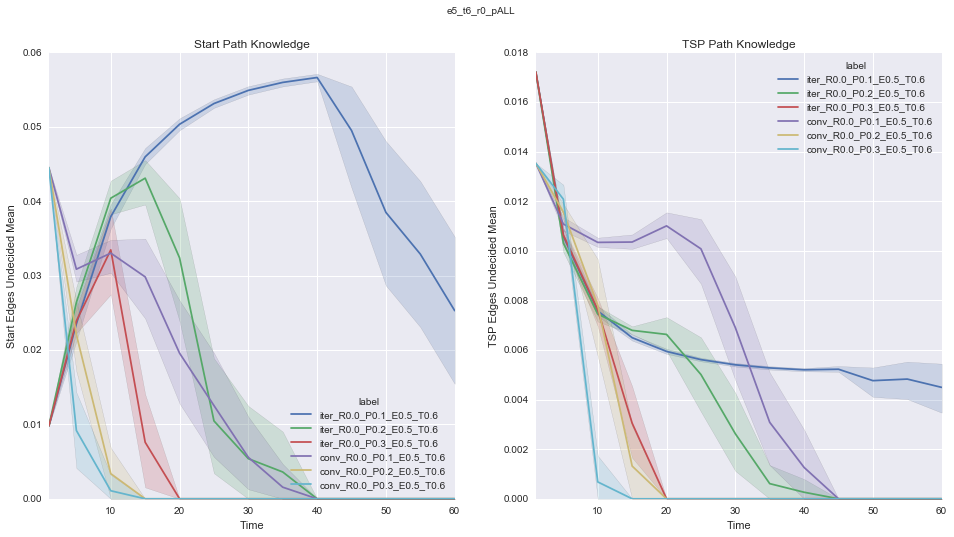

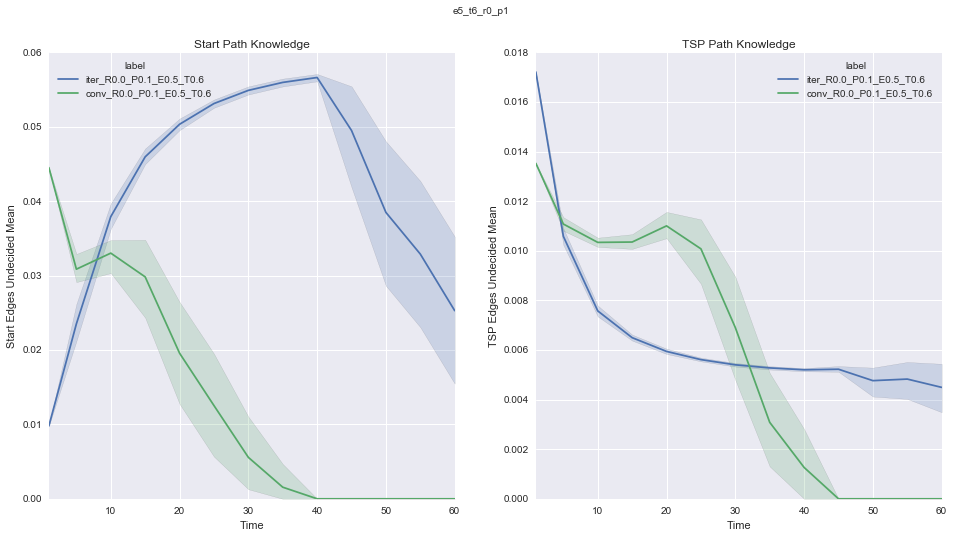

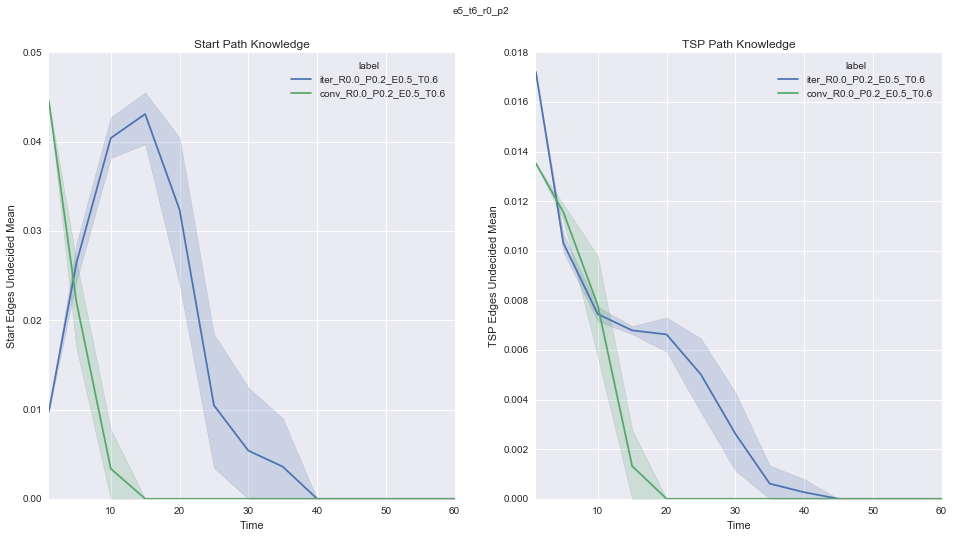

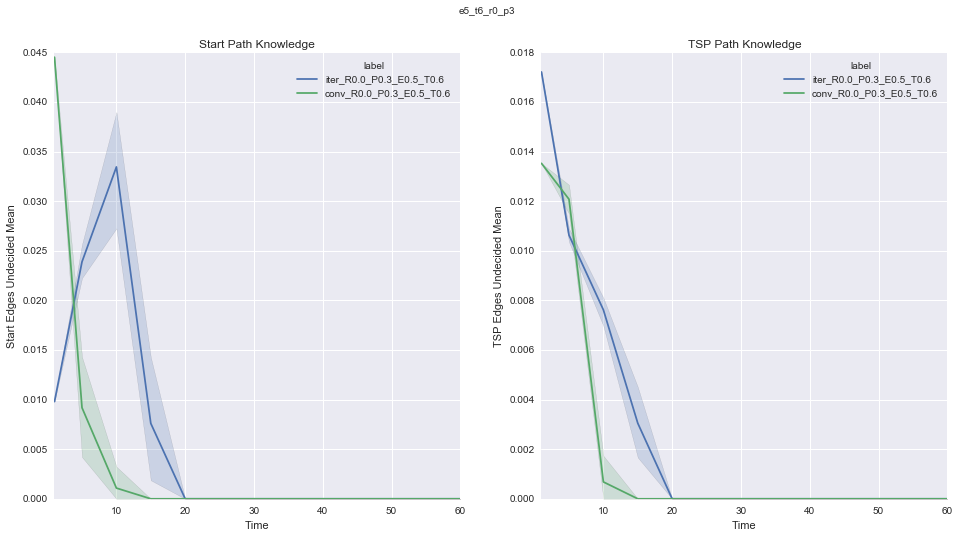

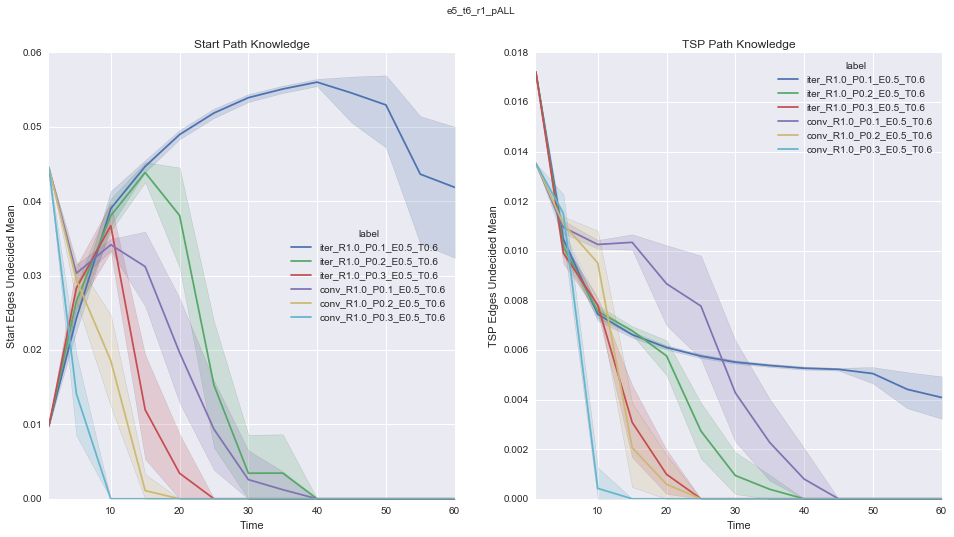

...

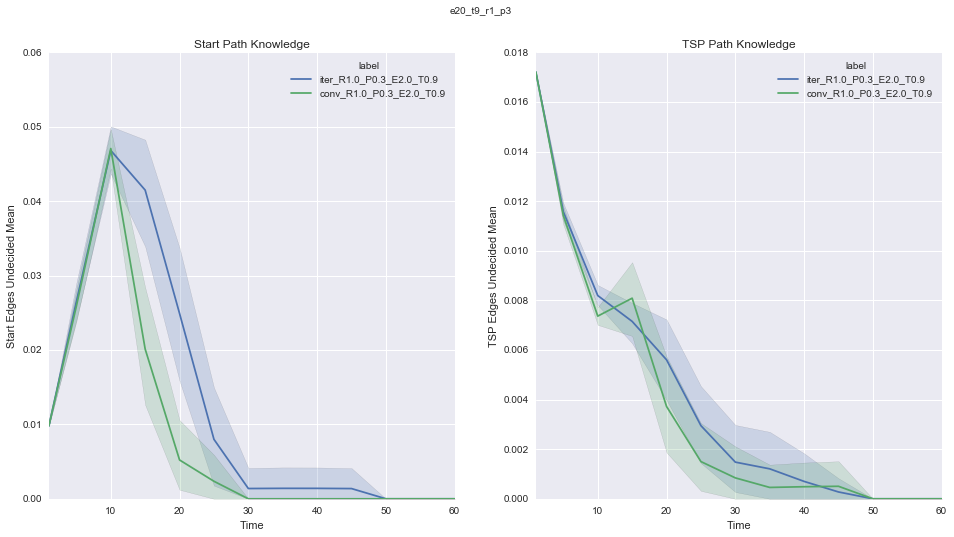

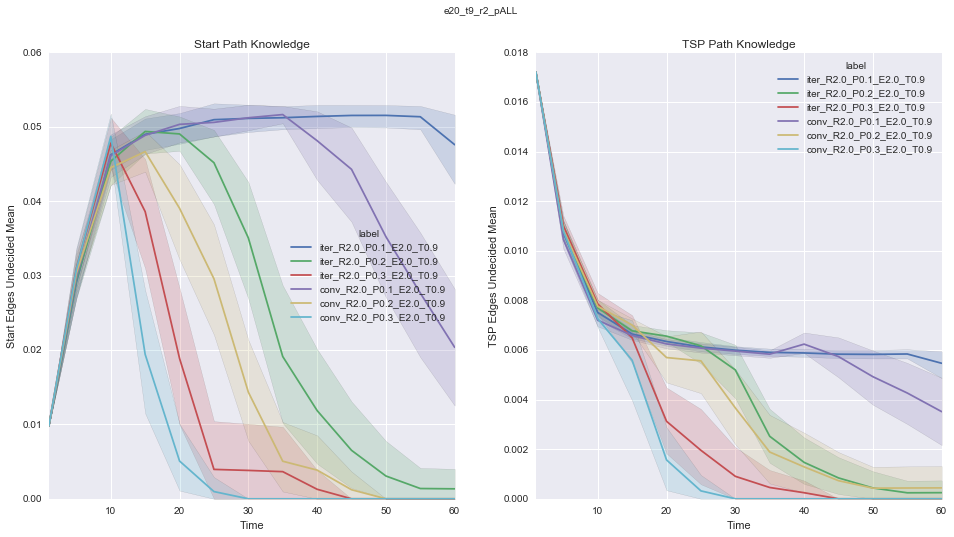

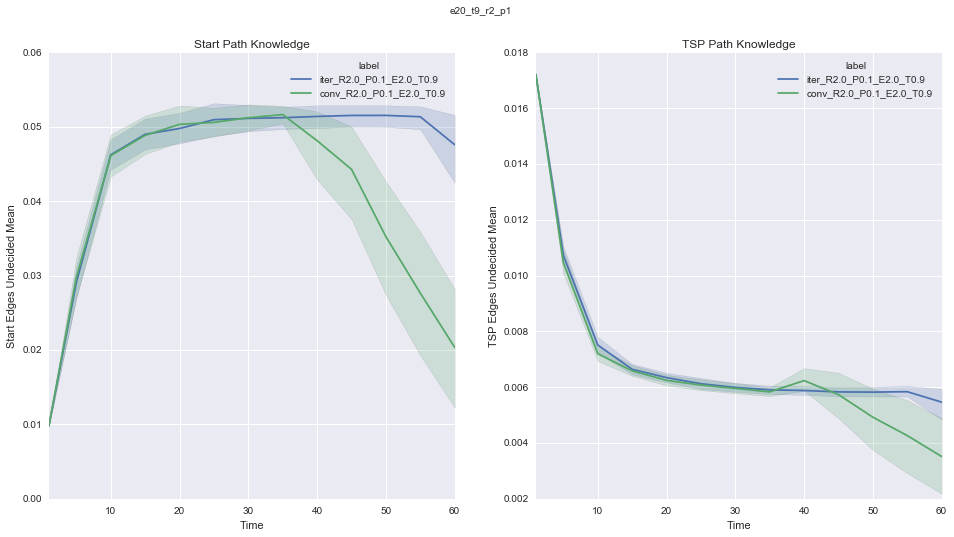

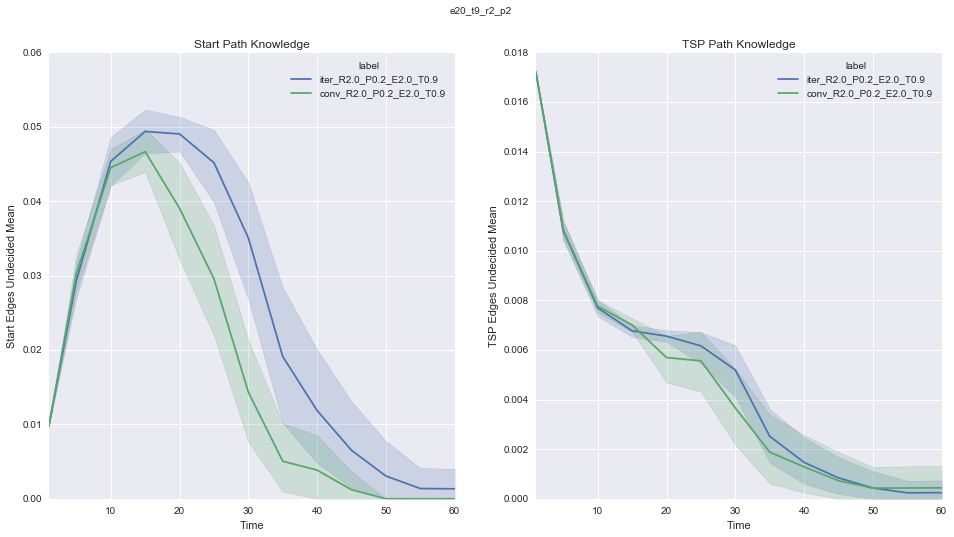

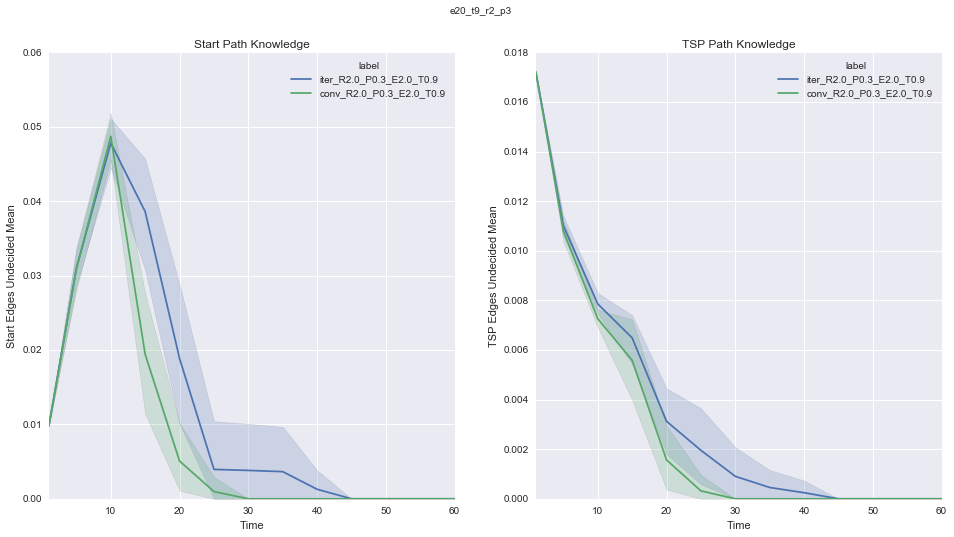

In [50]:
#data check
figsize=(16,8)
analysis='hits-h'
layer='k'
#for each parameter tuple, compare iterative vs. convergent design
for exp in exp_l:
    for tol in tol_l:
        for rug in rug_l:
            #compare all dissipations at once
            all_plot_df=cent_o.loc[(cent_o['centrality']==analysis) &
                                  (cent_o['layer']==layer) &
                                  (cent_o['exp']==exp) &
                                  (cent_o['tol']==tol) &
                                  (cent_o['rug']==rug)].reset_index(drop=True).fillna(0.0)
            f,a=plt.subplots(1,2,figsize=figsize)
            sns.tsplot(time='Time', value='Start Edges Undecided Mean', condition='label', unit='run', data=all_plot_df, ci=95, ax=a[0])
            sns.tsplot(time='Time', value='TSP Edges Undecided Mean', condition='label', unit='run', data=all_plot_df, ci=95, ax=a[1])
            a[0].set_title('Start Path Knowledge')
            a[1].set_title('TSP Path Knowledge')
            title='e{}_t{}_r{}_pALL'.format(int(exp*10),int(tol*10),int(rug))
            f.suptitle(title)
            f.savefig('{}\{}\{}\{}.png'.format(dir_name,experiment,'figs',title))
                    
            for diss in diss_l:
                #separates
                diss_plot_df=all_plot_df.loc[(all_plot_df['p']==diss)].reset_index(drop=True).fillna(0.0)
                f,a=plt.subplots(1,2,figsize=figsize)
                sns.tsplot(time='Time', value='Start Edges Undecided Mean', condition='label', unit='run', data=diss_plot_df, ci=95, ax=a[0])
                sns.tsplot(time='Time', value='TSP Edges Undecided Mean', condition='label', unit='run', data=diss_plot_df, ci=95, ax=a[1])
                a[0].set_title('Start Path Knowledge')
                a[1].set_title('TSP Path Knowledge')
                title='e{}_t{}_r{}_p{}'.format(int(exp*10),int(tol*10),int(rug),int(diss*10))
                f.suptitle(title)
                f.savefig('{}\{}\{}\{}.png'.format(dir_name,experiment,'figs',title))

In [51]:
for exp in exp_l:
    for tol in tol_l:
        for rug in rug_l:                 
            for diss in diss_l:
                #separates
                label_suffix='R{}_P{}_E{}_T{}'.format(rug,diss,exp,tol)
                c_label='conv_{}'.format(label_suffix)
                i_label='iter_{}'.format(label_suffix)
                print c_label
                print i_label
                print opt_df.loc[opt_df['label']==c_label]
                print opt_df.loc[opt_df['label']==i_label]
                

conv_R0.0_P0.1_E0.5_T0.6
iter_R0.0_P0.1_E0.5_T0.6
                        label  Any  End
108  conv_R0.0_P0.1_E0.5_T0.6  1.0  1.0
                      label  Any  End
0  iter_R0.0_P0.1_E0.5_T0.6  1.0  1.0
conv_R0.0_P0.2_E0.5_T0.6
iter_R0.0_P0.2_E0.5_T0.6
                        label  Any  End
120  conv_R0.0_P0.2_E0.5_T0.6  1.0  1.0
                       label  Any  End
12  iter_R0.0_P0.2_E0.5_T0.6  1.0  1.0
conv_R0.0_P0.3_E0.5_T0.6
iter_R0.0_P0.3_E0.5_T0.6
                        label  Any  End
132  conv_R0.0_P0.3_E0.5_T0.6  1.0  1.0
                       label  Any  End
24  iter_R0.0_P0.3_E0.5_T0.6  1.0  1.0
conv_R1.0_P0.1_E0.5_T0.6
iter_R1.0_P0.1_E0.5_T0.6
                        label  Any  End
144  conv_R1.0_P0.1_E0.5_T0.6  0.9  0.5
                       label       Any       End
36  iter_R1.0_P0.1_E0.5_T0.6  0.966667  0.366667
conv_R1.0_P0.2_E0.5_T0.6
iter_R1.0_P0.2_E0.5_T0.6
                        label       Any       End
156  conv_R1.0_P0.2_E0.5_T0.6  0.533333  0.266667


In [41]:
opt_df.loc[opt_df['label']=='conv_R2.0_P0.2_E2.0_T0.7']
rug=2.0
diss=0.2
exp=2.0
tol=0.8
label_suffix='R{}_P{}_E{}_T{}'.format(rug,diss,exp,tol)
c_label='conv_{}'.format(label_suffix)
print opt_df
print opt_df.loc[opt_df['label']==c_label]

                       label       Any       End
0   iter_R0.0_P0.1_E2.0_T0.5  1.000000  1.000000
1   iter_R0.0_P0.1_E2.0_T0.7  1.000000  1.000000
2   iter_R0.0_P0.1_E2.0_T0.9  1.000000  1.000000
3   iter_R0.0_P0.2_E2.0_T0.5  1.000000  1.000000
4   iter_R0.0_P0.2_E2.0_T0.7  1.000000  1.000000
5   iter_R0.0_P0.2_E2.0_T0.9  1.000000  1.000000
6   iter_R0.0_P0.3_E2.0_T0.5  1.000000  1.000000
7   iter_R0.0_P0.3_E2.0_T0.7  1.000000  1.000000
8   iter_R0.0_P0.3_E2.0_T0.9  1.000000  1.000000
9   iter_R1.0_P0.1_E2.0_T0.5  0.966667  0.300000
10  iter_R1.0_P0.1_E2.0_T0.7  0.933333  0.333333
11  iter_R1.0_P0.1_E2.0_T0.9  1.000000  0.233333
12  iter_R1.0_P0.2_E2.0_T0.5  0.500000  0.200000
13  iter_R1.0_P0.2_E2.0_T0.7  0.766667  0.333333
14  iter_R1.0_P0.2_E2.0_T0.9  0.800000  0.400000
15  iter_R1.0_P0.3_E2.0_T0.5  0.433333  0.233333
16  iter_R1.0_P0.3_E2.0_T0.7  0.533333  0.266667
17  iter_R1.0_P0.3_E2.0_T0.9  0.366667  0.266667
18  iter_R2.0_P0.1_E2.0_T0.5  1.000000  0.833333
19  iter_R2.0_P0.1_E

In [4]:
analysis='hits-h'
layer='k'
#for each parameter tuple, compare iterative vs. convergent design
for exp in exp_l:
    for tol in tol_l:
        for rug in rug_l:
            #compare all dissipations at once
            all_plot_df=cent_o.loc[(cent_o['centrality']==analysis) &
                                  (cent_o['layer']==layer) &
                                  (cent_o['exp']==exp) &
                                  (cent_o['tol']==tol) &
                                  (cent_o['rug']==rug)].reset_index(drop=True).fillna(0.0)
                    
            for diss in diss_l:
                diss_plot_df=all_plot_df.loc[(all_plot_df['p']==diss)].reset_index(drop=True).fillna(0.0)
                print diss_plot_df.head()

                      label  run  N  rug    p  exp  tol criteria method  \
0  iter_R0.0_P0.1_E0.5_T0.6    0  5  0.0  0.1  0.5  0.6      abs   iter   
1  iter_R0.0_P0.1_E0.5_T0.6    0  5  0.0  0.1  0.5  0.6      abs   iter   
2  iter_R0.0_P0.1_E0.5_T0.6    0  5  0.0  0.1  0.5  0.6      abs   iter   
3  iter_R0.0_P0.1_E0.5_T0.6    0  5  0.0  0.1  0.5  0.6      abs   iter   
4  iter_R0.0_P0.1_E0.5_T0.6    0  5  0.0  0.1  0.5  0.6      abs   iter   

   force            ...             TSP Edges Solution Sum  \
0    0.0            ...                           0.115351   
1    0.0            ...                           0.119208   
2    0.0            ...                           0.059037   
3    0.0            ...                           0.046698   
4    0.0            ...                           0.043695   

   TSP Edges Eliminated Sum  TSP Edges Undecided Sum  TSP Edges Locked-In Sum  \
0                       0.0                 0.413063                      0.0   
1             

In [94]:
rows=['Start Edges Undecided Sum','TSP Edges Undecided Sum']
df=cent_o.loc[(cent_o['centrality']==analysis) & (cent_o['layer']==layer)].reset_index(drop=True).fillna(0.0)
df=df.groupby(['method','exp','tol','rug','p','Time'])['Start Edges Undecided Sum','TSP Edges Undecided Sum'].mean().reset_index()
# print df

diff_list=[]
for e in df['exp'].unique():
    for tol in df['tol'].unique():
        for r in df['rug'].unique():
            for p in df['p'].unique():
                dt=df.loc[(df['exp']==e) & (df['tol']==tol) & (df['rug']==r) & (df['p']==p)]
                for t in dt['Time'].unique():
    #                 print t
                    i=dt.loc[(dt['Time']==t) & (dt['method']=='iter')]
                    c=dt.loc[(dt['Time']==t) & (dt['method']=='conv')]
    #                 print i
    #                 print c
    #                 print 'difference'
                    row_diff=i[rows].values-c[rows].values
                    row_diff=np.insert(row_diff,0,[e,tol,r,p,t])
    #                 print row_diff
                    diff_list.append(row_diff)


diff=np.vstack(diff_list)
# print diff
param_l=['exp','tol','rug','p','Time']
diff_labels=['Start','TSP']
diff_df=pd.DataFrame(diff,columns=[param_l+diff_labels])

print diff_df

      exp  tol  rug    p  Time     Start           TSP
0     0.5  0.6  0.0  0.1   1.0 -0.074750  8.842750e-02
1     0.5  0.6  0.0  0.1   5.0  0.089376 -1.722693e-02
2     0.5  0.6  0.0  0.1  10.0  0.241135 -9.457800e-02
3     0.5  0.6  0.0  0.1  15.0  0.338395 -1.215389e-01
4     0.5  0.6  0.0  0.1  20.0  0.425088 -9.945747e-02
5     0.5  0.6  0.0  0.1  25.0  0.481112 -4.314210e-02
6     0.5  0.6  0.0  0.1  30.0  0.526670  4.691115e-02
7     0.5  0.6  0.0  0.1  35.0  0.553424  1.569868e-01
8     0.5  0.6  0.0  0.1  40.0  0.566249  1.908327e-01
9     0.5  0.6  0.0  0.1  45.0  0.495057  2.028332e-01
10    0.5  0.6  0.0  0.1  50.0  0.384939  1.766967e-01
11    0.5  0.6  0.0  0.1  55.0  0.328949  1.621755e-01
12    0.5  0.6  0.0  0.1  60.0  0.252899  1.445170e-01
13    0.5  0.6  0.0  0.2   1.0 -0.074750  8.842750e-02
14    0.5  0.6  0.0  0.2   5.0  0.135256 -6.340598e-03
15    0.5  0.6  0.0  0.2  10.0  0.377221  1.176840e-01
16    0.5  0.6  0.0  0.2  15.0  0.425960  2.518799e-01
17    0.5 

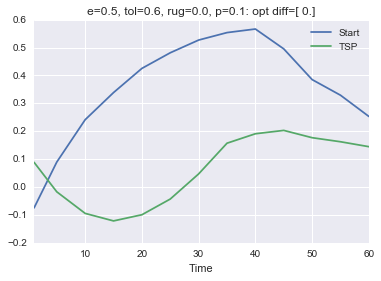

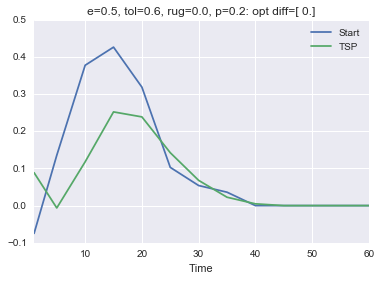

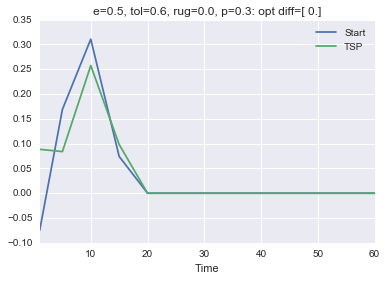

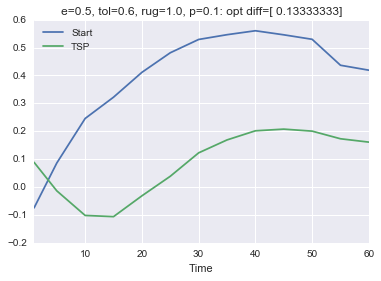

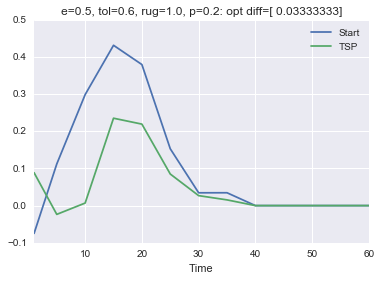

...

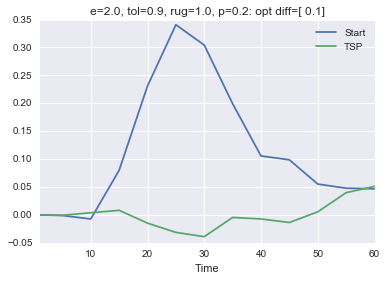

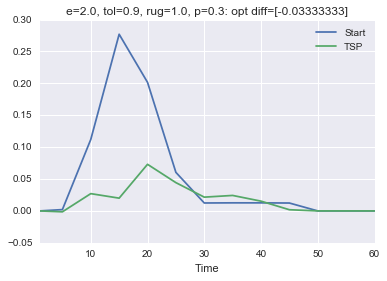

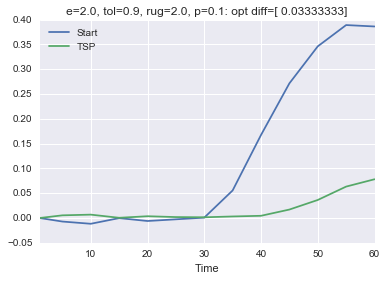

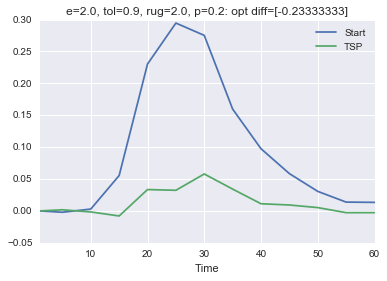

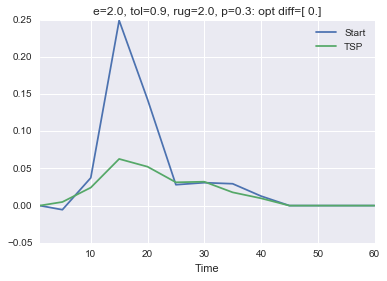

In [95]:
for e in diff_df['exp'].unique():
    for tol in diff_df['tol'].unique():
        for r in diff_df['rug'].unique():
            for p in diff_df['p'].unique():
                #get optimality difference
                label_suffix='R{}_P{}_E{}_T{}'.format(r,p,e,tol)
                c_label='conv_{}'.format(label_suffix)
                i_label='iter_{}'.format(label_suffix)
                i_opt=opt_df.loc[opt_df['label']==i_label]['End'].values
                c_opt=opt_df.loc[opt_df['label']==c_label]['End'].values
                opt_diff=c_opt-i_opt               
                
                
                dt=diff_df.loc[(diff_df['exp']==e) & (diff_df['tol']==tol) & (diff_df['rug']==r) & (diff_df['p']==p)]
                dt.plot(x='Time', y=diff_labels)
                plt.title('e={}, tol={}, rug={}, p={}: opt diff={}'.format(e,tol,r,p,opt_diff))

In [33]:
d={'Time':pd.Series([0,0,5,5],index=['iter','conv','iter','conv']),
    'Start':pd.Series([0.0,1.0,0.0,2.0],index=['iter','conv','iter','conv']),
    'TSP':pd.Series([1.0,0.0,2.0,0.0],index=['iter','conv','iter','conv'])}
dt=pd.DataFrame(d)
print dt
dd=dt.diff()
print dd
print dd.loc[['conv']]

      Start  TSP  Time
iter    0.0  1.0     0
conv    1.0  0.0     0
iter    0.0  2.0     5
conv    2.0  0.0     5
      Start  TSP  Time
iter    NaN  NaN   NaN
conv    1.0 -1.0   0.0
iter   -1.0  2.0   5.0
conv    2.0 -2.0   0.0
      Start  TSP  Time
conv    1.0 -1.0   0.0
conv    2.0 -2.0   0.0


In [35]:
d={'method':pd.Series(['iter','conv','iter','conv']),
    'Time':pd.Series([0,0,5,5]),
    'Start':pd.Series([0.0,1.0,0.0,2.0]),
    'TSP':pd.Series([1.0,0.0,2.0,0.0])}
dt=pd.DataFrame(d).set_index('method')
print dt
dd=dt.diff()
print dd
print dd.loc[['conv']]

        Start  TSP  Time
method                  
iter      0.0  1.0     0
conv      1.0  0.0     0
iter      0.0  2.0     5
conv      2.0  0.0     5
        Start  TSP  Time
method                  
iter      NaN  NaN   NaN
conv      1.0 -1.0   0.0
iter     -1.0  2.0   5.0
conv      2.0 -2.0   0.0
        Start  TSP  Time
method                  
conv      1.0 -1.0   0.0
conv      2.0 -2.0   0.0


In [68]:
dt=pd.DataFrame(d)
print dt
diff_list=[]#pd.DataFrame(columns=('Time','Start','TSP'))
for t in dt['Time'].unique():
    i=dt.loc[(dt['Time']==t) & (dt['method']=='iter')]
    c=dt.loc[(dt['Time']==t) & (dt['method']=='conv')]
    print i
    print c
    print 'difference'
    row_diff=i[['Start','TSP']].values-c[['Start','TSP']].values
    row_diff=np.insert(row_diff,0,t)
    print row_diff
    diff_list.append(row_diff)

print diff_list
diff=np.vstack(diff_list)

diff_df=pd.DataFrame(diff,columns=('Time','Start','TSP'))

print diff_df

   Start  TSP  Time method
0    0.0  1.0     0   iter
1    1.0  0.0     0   conv
2    0.0  2.0     5   iter
3    2.0  0.0     5   conv
   Start  TSP  Time method
0    0.0  1.0     0   iter
   Start  TSP  Time method
1    1.0  0.0     0   conv
difference
[ 0. -1.  1.]
   Start  TSP  Time method
2    0.0  2.0     5   iter
   Start  TSP  Time method
3    2.0  0.0     5   conv
difference
[ 5. -2.  2.]
[array([ 0., -1.,  1.]), array([ 5., -2.,  2.])]
   Time  Start  TSP
0   0.0   -1.0  1.0
1   5.0   -2.0  2.0
